<a href="https://colab.research.google.com/github/OmdenaAI/SanJoseUSAChapter_ChronicDiseaseRisk/blob/main/Lab_data.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

##Lets start the Feature engineering for the Laboratory Data from NHANES data set

Importing the necessary libraries

In [1]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings('ignore')

In [2]:
#read the data and see the first 5 rows
lab_data = pd.read_csv('/content/Merged_Lab_Data.csv')
lab_data.head()

,SEQN,LBXHSCRP,LBDHRPLC,LBXHBS,WTSAFPRP,LBXGLU,LBDGLUSI,WTSAFPRP_1,LBXIN,LBDINSI,...,LBDIHGSI,LBDIHGLC,LBXBGE,LBDBGESI,LBDBGELC,LBXBGM,LBDBGMSI,LBDBGMLC,LBXTC,LBDTCSI
0,109263.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,109264.0,0.11,1.000000e+00,2.0,27533.174559,97.0,5.38,27533.174559,6.05,36.3,...,0.75,1.000000e+00,0.05,0.25,1.0,0.18,0.9,1.0,166.0,4.29
2,109265.0,0.31,5.397605e-79,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.75,1.000000e+00,0.05,0.25,1.0,0.18,0.9,1.0,NaN,NaN
3,109266.0,0.72,5.397605e-79,1.0,NaN,NaN,NaN,NaN,NaN,NaN,...,1.20,5.397605e-79,0.05,0.25,1.0,0.18,0.9,1.0,195.0,5.04
4,109269.0,0.73,5.397605e-79,1.0,NaN,NaN,NaN,NaN,NaN,NaN,...,0.75,1.000000e+00,0.05,0.25,1.0,0.18,0.9,1.0,NaN,NaN


In [3]:
#The info about the types and other parts on the data
lab_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 13772 entries, 0 to 13771
Columns: 300 entries, SEQN to LBDTCSI
dtypes: float64(300)
memory usage: 31.5 MB


In [4]:
#describe and see it's counterparts for the min std and others
lab_data.describe()

,SEQN,LBXHSCRP,LBDHRPLC,LBXHBS,WTSAFPRP,LBXGLU,LBDGLUSI,WTSAFPRP_1,LBXIN,LBDINSI,...,LBDIHGSI,LBDIHGLC,LBXBGE,LBDBGESI,LBDBGELC,LBXBGM,LBDBGMSI,LBDBGMLC,LBXTC,LBDTCSI
count,13772.000000,11614.000000,1.161400e+04,11610.000000,5.090000e+03,4744.000000,4744.000000,5.090000e+03,4625.000000,4625.000000,...,12029.000000,1.202900e+04,12029.000000,12029.000000,1.202900e+04,12029.000000,12029.000000,1.202900e+04,10828.000000,10828.000000
mean,117079.858844,3.422093,3.426899e-02,1.695004,5.388396e+04,111.182125,6.171739,5.388396e+04,14.975684,89.854106,...,1.080459,8.044725e-01,0.050426,0.252127,9.934325e-01,0.893482,4.459567,4.380248e-01,177.463521,4.589243
std,4498.549164,7.792654,1.819271e-01,0.460425,6.853813e+04,36.314648,2.016121,6.853813e+04,22.845041,137.070249,...,2.864987,3.966227e-01,0.010282,0.051333,8.077668e-02,1.779293,8.878261,4.961648e-01,40.355743,1.043624
min,109263.000000,0.110000,5.397605e-79,1.000000,5.397605e-79,47.000000,2.610000,5.397605e-79,0.710000,4.260000,...,0.750000,5.397605e-79,0.050000,0.250000,5.397605e-79,0.180000,0.900000,5.397605e-79,71.000000,1.840000
25%,113184.750000,0.520000,5.397605e-79,1.000000,1.730597e+04,95.000000,5.270000,1.730597e+04,6.310000,37.860000,...,0.750000,1.000000e+00,0.050000,0.250000,1.000000e+00,0.180000,0.900000,5.397605e-79,149.000000,3.850000
50%,117104.500000,1.320000,5.397605e-79,2.000000,3.284510e+04,102.000000,5.660000,3.284510e+04,10.180000,61.080000,...,0.750000,1.000000e+00,0.050000,0.250000,1.000000e+00,0.320000,1.600000,5.397605e-79,173.000000,4.470000
75%,120981.250000,3.620000,5.397605e-79,2.000000,6.213588e+04,112.000000,6.220000,6.213588e+04,16.610000,99.660000,...,0.750000,1.000000e+00,0.050000,0.250000,1.000000e+00,0.870000,4.340000,1.000000e+00,201.000000,5.200000
max,124822.000000,246.860000,1.000000e+00,2.000000,7.412592e+05,524.000000,29.100000,7.412592e+05,512.500000,3075.000000,...,169.410000,1.000000e+00,1.010000,5.040000,1.000000e+00,55.900000,278.940000,1.000000e+00,446.000000,11.530000


In [5]:
#Lets see how much we have data tha are missing
lab_data.isnull().sum()

,0
SEQN,0
LBXHSCRP,2158
LBDHRPLC,2158
LBXHBS,2162
WTSAFPRP,8682
...,...
LBXBGM,1743
LBDBGMSI,1743
LBDBGMLC,1743
LBXTC,2944


In [6]:
#trying the data percentage finding
lab_data_percent_missing = lab_data.isnull().sum() * 100 / len(lab_data)
lab_data_percent_missing

,0
SEQN,0.000000
LBXHSCRP,15.669474
LBDHRPLC,15.669474
LBXHBS,15.698519
WTSAFPRP,63.040953
...,...
LBXBGM,12.656114
LBDBGMSI,12.656114
LBDBGMLC,12.656114
LBXTC,21.376706


In [7]:
#much mising parts of the dta like more or equal to 65%
lab_data_high_missing = lab_data_percent_missing[lab_data_percent_missing >= 65]
lab_data_high_missing

,0
LBXGLU,65.553297
LBDGLUSI,65.553297
LBXIN,66.417369
LBDINSI,66.417369
LBDINLC,66.417369
...,...
PHAGUMMN,97.044728
PHAANTHR,99.201278
PHAANTMN,99.201278
PHASUPHR,98.017717


In [8]:
#As here can be said we most could have more variables that we need so lets see overal all the data about the cholesterol
Lab_cholesterol = ['LBDHDD','LBDHDDSI','LBXTR','LBDTRSI','LBDLDL','LBDLDLSI','LBDLDLM','LBDLDMSI','LBDLDLN','LBDLDNSI','WTSAFPRP','LBXTC','LBDTCSI']
lab_data_cholesterol = lab_data[Lab_cholesterol]
lab_data_cholesterol


,LBDHDD,LBDHDDSI,LBXTR,LBDTRSI,LBDLDL,LBDLDLSI,LBDLDLM,LBDLDMSI,LBDLDLN,LBDLDNSI,WTSAFPRP,LBXTC,LBDTCSI
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,72.0,1.86,40.0,0.452,86.0,2.224,82.0,2.121,85.0,2.198,27533.174559,166.0,4.29
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,56.0,1.45,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,195.0,5.04
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...
13767,50.0,1.29,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,234.0,6.05
13768,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
13769,64.0,1.66,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,179.0,4.63
13770,44.0,1.14,51.0,0.576,101.0,2.612,98.0,2.534,100.0,2.586,10704.467871,155.0,4.01


In [9]:
#lets see the same question as describe counter parts missing values and the high mssing values and see how to go on
lab_data_cholesterol.isnull().sum()
lab_data_cholesterol.describe()

,LBDHDD,LBDHDDSI,LBXTR,LBDTRSI,LBDLDL,LBDLDLSI,LBDLDLM,LBDLDMSI,LBDLDLN,LBDLDNSI,WTSAFPRP,LBXTC,LBDTCSI
count,10828.000000,10828.000000,4650.000000,4650.000000,4617.000000,4617.000000,4617.000000,4617.000000,4642.000000,4642.000000,5.090000e+03,10828.000000,10828.000000
mean,53.473864,1.382979,103.715484,1.170958,105.233918,2.721358,105.513104,2.728581,106.766911,2.761004,5.388396e+04,177.463521,4.589243
std,15.037712,0.388828,89.822555,1.014096,35.210562,0.910537,35.188769,0.909980,35.925723,0.929039,6.853813e+04,40.355743,1.043624
min,5.000000,0.130000,10.000000,0.113000,7.000000,0.181000,14.000000,0.362000,14.000000,0.362000,5.397605e-79,71.000000,1.840000
25%,43.000000,1.110000,56.000000,0.632000,81.000000,2.095000,81.000000,2.095000,81.000000,2.095000,1.730597e+04,149.000000,3.850000
50%,51.000000,1.320000,84.000000,0.948000,101.000000,2.612000,102.000000,2.638000,103.000000,2.664000,3.284510e+04,173.000000,4.470000
75%,61.000000,1.580000,126.000000,1.423000,126.000000,3.258000,127.000000,3.284000,128.000000,3.310000,6.213588e+04,201.000000,5.200000
max,189.000000,4.890000,2684.000000,30.302000,357.000000,9.232000,358.000000,9.258000,359.000000,9.284000,7.412592e+05,446.000000,11.530000


In [10]:
lab_data_cholesterol_percent_missing = lab_data_cholesterol.isnull().sum() * 100 / len(lab_data_cholesterol)
lab_data_cholesterol_percent_missing

,0
LBDHDD,21.376706
LBDHDDSI,21.376706
LBXTR,66.235841
LBDTRSI,66.235841
LBDLDL,66.475457
LBDLDLSI,66.475457
LBDLDLM,66.475457
LBDLDMSI,66.475457
LBDLDLN,66.293930
LBDLDNSI,66.293930


In [11]:
lab_data_cholesterol_high_missing = lab_data_cholesterol_percent_missing[lab_data_cholesterol_percent_missing >= 65]
lab_data_cholesterol_high_missing

,0
LBXTR,66.235841
LBDTRSI,66.235841
LBDLDL,66.475457
LBDLDLSI,66.475457
LBDLDLM,66.475457
LBDLDMSI,66.475457
LBDLDLN,66.293930
LBDLDNSI,66.293930


In [12]:
#lets fill first the data with mean than median parts
lab_data_cholesterol_fillna_mean = lab_data_cholesterol.fillna(lab_data_cholesterol.mean())
lab_data_cholesterol_fillna_mean

,LBDHDD,LBDHDDSI,LBXTR,LBDTRSI,LBDLDL,LBDLDLSI,LBDLDLM,LBDLDMSI,LBDLDLN,LBDLDNSI,WTSAFPRP,LBXTC,LBDTCSI
0,53.473864,1.382979,103.715484,1.170958,105.233918,2.721358,105.513104,2.728581,106.766911,2.761004,53883.958149,177.463521,4.589243
1,72.000000,1.860000,40.000000,0.452000,86.000000,2.224000,82.000000,2.121000,85.000000,2.198000,27533.174559,166.000000,4.290000
2,53.473864,1.382979,103.715484,1.170958,105.233918,2.721358,105.513104,2.728581,106.766911,2.761004,53883.958149,177.463521,4.589243
3,56.000000,1.450000,103.715484,1.170958,105.233918,2.721358,105.513104,2.728581,106.766911,2.761004,53883.958149,195.000000,5.040000
4,53.473864,1.382979,103.715484,1.170958,105.233918,2.721358,105.513104,2.728581,106.766911,2.761004,53883.958149,177.463521,4.589243
...,...,...,...,...,...,...,...,...,...,...,...,...,...
13767,50.000000,1.290000,103.715484,1.170958,105.233918,2.721358,105.513104,2.728581,106.766911,2.761004,53883.958149,234.000000,6.050000
13768,53.473864,1.382979,103.715484,1.170958,105.233918,2.721358,105.513104,2.728581,106.766911,2.761004,53883.958149,177.463521,4.589243
13769,64.000000,1.660000,103.715484,1.170958,105.233918,2.721358,105.513104,2.728581,106.766911,2.761004,53883.958149,179.000000,4.630000
13770,44.000000,1.140000,51.000000,0.576000,101.000000,2.612000,98.000000,2.534000,100.000000,2.586000,10704.467871,155.000000,4.010000


In [13]:
lab_data_cholesterol_fillna_median = lab_data_cholesterol.fillna(lab_data_cholesterol.median())
lab_data_cholesterol_fillna_median

,LBDHDD,LBDHDDSI,LBXTR,LBDTRSI,LBDLDL,LBDLDLSI,LBDLDLM,LBDLDMSI,LBDLDLN,LBDLDNSI,WTSAFPRP,LBXTC,LBDTCSI
0,51.0,1.32,84.0,0.948,101.0,2.612,102.0,2.638,103.0,2.664,32845.099026,173.0,4.47
1,72.0,1.86,40.0,0.452,86.0,2.224,82.0,2.121,85.0,2.198,27533.174559,166.0,4.29
2,51.0,1.32,84.0,0.948,101.0,2.612,102.0,2.638,103.0,2.664,32845.099026,173.0,4.47
3,56.0,1.45,84.0,0.948,101.0,2.612,102.0,2.638,103.0,2.664,32845.099026,195.0,5.04
4,51.0,1.32,84.0,0.948,101.0,2.612,102.0,2.638,103.0,2.664,32845.099026,173.0,4.47
...,...,...,...,...,...,...,...,...,...,...,...,...,...
13767,50.0,1.29,84.0,0.948,101.0,2.612,102.0,2.638,103.0,2.664,32845.099026,234.0,6.05
13768,51.0,1.32,84.0,0.948,101.0,2.612,102.0,2.638,103.0,2.664,32845.099026,173.0,4.47
13769,64.0,1.66,84.0,0.948,101.0,2.612,102.0,2.638,103.0,2.664,32845.099026,179.0,4.63
13770,44.0,1.14,51.0,0.576,101.0,2.612,98.0,2.534,100.0,2.586,10704.467871,155.0,4.01


In [14]:
#If trying to to see the both data's correlations and see what will be.
lab_data_cholesterol_fillna_mean.corr()

,LBDHDD,LBDHDDSI,LBXTR,LBDTRSI,LBDLDL,LBDLDLSI,LBDLDLM,LBDLDMSI,LBDLDLN,LBDLDNSI,WTSAFPRP,LBXTC,LBDTCSI
LBDHDD,1.000000,0.999973,-0.223632,-0.223634,-0.005766,-0.005758,-0.039211,-0.039210,-0.013925,-0.013924,0.007470,0.214706,0.214707
LBDHDDSI,0.999973,1.000000,-0.223620,-0.223622,-0.005877,-0.005870,-0.039303,-0.039302,-0.014022,-0.014021,0.007501,0.214589,0.214591
LBXTR,-0.223632,-0.223620,1.000000,1.000000,0.137392,0.137386,0.221968,0.221967,0.175039,0.175042,0.018190,0.208340,0.208289
LBDTRSI,-0.223634,-0.223622,1.000000,1.000000,0.137393,0.137387,0.221970,0.221969,0.175040,0.175044,0.018184,0.208340,0.208290
LBDLDL,-0.005766,-0.005877,0.137392,0.137393,1.000000,1.000000,0.991064,0.991064,0.993248,0.993248,0.041772,0.607503,0.607490
LBDLDLSI,-0.005758,-0.005870,0.137386,0.137387,1.000000,1.000000,0.991063,0.991063,0.993247,0.993247,0.041772,0.607504,0.607491
LBDLDLM,-0.039211,-0.039303,0.221968,0.221970,0.991064,0.991063,1.000000,1.000000,0.992196,0.992196,0.042382,0.614660,0.614644
LBDLDMSI,-0.039210,-0.039302,0.221967,0.221969,0.991064,0.991063,1.000000,1.000000,0.992196,0.992195,0.042390,0.614661,0.614645
LBDLDLN,-0.013925,-0.014022,0.175039,0.175040,0.993248,0.993247,0.992196,0.992196,1.000000,1.000000,0.042503,0.617994,0.617979
LBDLDNSI,-0.013924,-0.014021,0.175042,0.175044,0.993248,0.993247,0.992196,0.992195,1.000000,1.000000,0.042496,0.617995,0.617980


In [15]:
lab_data_cholesterol_fillna_median.corr()

,LBDHDD,LBDHDDSI,LBXTR,LBDTRSI,LBDLDL,LBDLDLSI,LBDLDLM,LBDLDMSI,LBDLDLN,LBDLDNSI,WTSAFPRP,LBXTC,LBDTCSI
LBDHDD,1.000000,0.999972,-0.213497,-0.213478,-0.001634,-0.001631,-0.035570,-0.035580,-0.010725,-0.010737,0.019080,0.217682,0.217792
LBDHDDSI,0.999972,1.000000,-0.213593,-0.213575,-0.001793,-0.001791,-0.035706,-0.035715,-0.010865,-0.010877,0.018939,0.217525,0.217634
LBXTR,-0.213497,-0.213593,1.000000,1.000000,0.145880,0.145863,0.227163,0.227139,0.184089,0.184046,0.068265,0.214447,0.214496
LBDTRSI,-0.213478,-0.213575,1.000000,1.000000,0.145903,0.145885,0.227177,0.227153,0.184106,0.184063,0.068341,0.214453,0.214501
LBDLDL,-0.001634,-0.001793,0.145880,0.145903,1.000000,1.000000,0.990999,0.990995,0.993110,0.993105,0.068276,0.608288,0.608286
LBDLDLSI,-0.001631,-0.001791,0.145863,0.145885,1.000000,1.000000,0.991000,0.990996,0.993111,0.993107,0.068242,0.608291,0.608289
LBDLDLM,-0.035570,-0.035706,0.227163,0.227177,0.990999,0.991000,1.000000,1.000000,0.992146,0.992147,0.064227,0.615554,0.615538
LBDLDMSI,-0.035580,-0.035715,0.227139,0.227153,0.990995,0.990996,1.000000,1.000000,0.992145,0.992146,0.064168,0.615555,0.615539
LBDLDLN,-0.010725,-0.010865,0.184089,0.184106,0.993110,0.993111,0.992146,0.992145,1.000000,1.000000,0.065763,0.619373,0.619360
LBDLDNSI,-0.010737,-0.010877,0.184046,0.184063,0.993105,0.993107,0.992147,0.992146,1.000000,1.000000,0.065655,0.619374,0.619361


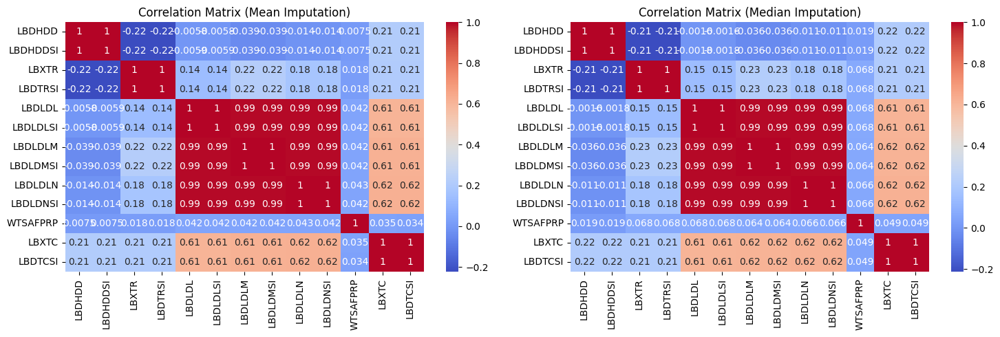

In [16]:
# prompt: heatmap subplot lab_data_cholesterol_fillna_mean.corr and  lab_data_cholesterol_fillna_median.corr

fig, axes = plt.subplots(1, 2, figsize=(15, 5))

sns.heatmap(lab_data_cholesterol_fillna_mean.corr(), annot=True, cmap='coolwarm', ax=axes[0])
axes[0].set_title('Correlation Matrix (Mean Imputation)')

sns.heatmap(lab_data_cholesterol_fillna_median.corr(), annot=True, cmap='coolwarm', ax=axes[1])
axes[1].set_title('Correlation Matrix (Median Imputation)')

plt.tight_layout()
plt.show()

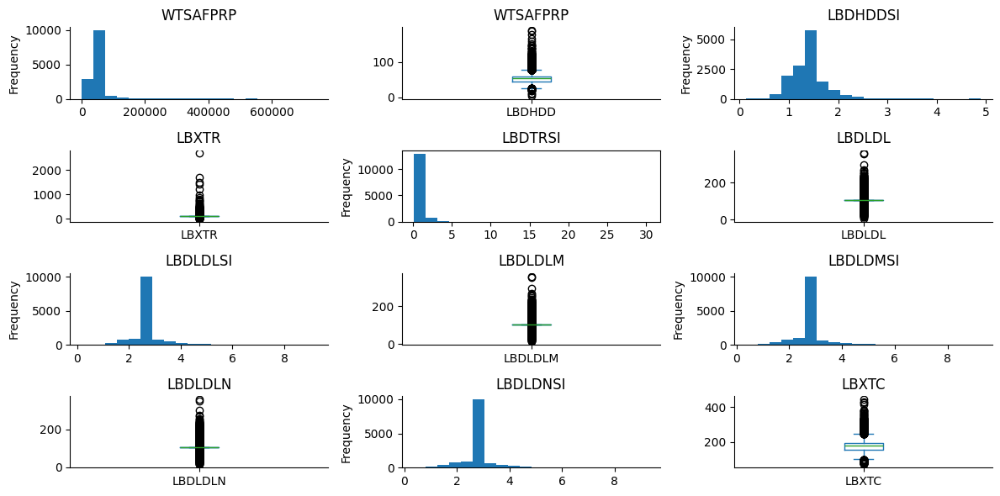

In [17]:
#lets see some plottings for some variables
import matplotlib.pyplot as plt
fig, axes = plt.subplots(4, 3, figsize=(12, 6))

lab_data_cholesterol_fillna_mean['WTSAFPRP'].plot(kind='hist', bins=20, title='WTSAFPRP', ax=axes[0,0])
axes[0,0].spines[['top', 'right']].set_visible(False)

lab_data_cholesterol_fillna_mean['LBDHDD'].plot(kind='box', title='WTSAFPRP', ax=axes[0,1])
axes[0,1].spines[['top', 'right']].set_visible(False)

lab_data_cholesterol_fillna_mean['LBDHDDSI'].plot(kind='hist', bins=20, title='LBDHDDSI', ax=axes[0,2])
axes[0,2].spines[['top', 'right']].set_visible(False)

lab_data_cholesterol_fillna_mean['LBXTR'].plot(kind='box', title='LBXTR', ax=axes[1,0])
axes[1,0].spines[['top', 'right']].set_visible(False)

lab_data_cholesterol_fillna_mean['LBDTRSI'].plot(kind='hist', bins=20, title='LBDTRSI', ax=axes[1,1])
axes[1,1].spines[['top', 'right']].set

lab_data_cholesterol_fillna_mean['LBDLDL'].plot(kind='box', title='LBDLDL', ax=axes[1,2])
axes[1,2].spines[['top', 'right']].set_visible(False)

lab_data_cholesterol_fillna_mean['LBDLDLSI'].plot(kind='hist', bins=20, title='LBDLDLSI', ax=axes[2,0])
axes[2,0].spines[['top', 'right']].set_visible(False)

lab_data_cholesterol_fillna_mean['LBDLDLM'].plot(kind='box', title='LBDLDLM', ax=axes[2,1])
axes[2,1].spines[['top', 'right']].set_visible(False)

lab_data_cholesterol_fillna_mean['LBDLDMSI'].plot(kind='hist', bins=20, title='LBDLDMSI', ax=axes[2,2])
axes[2,2].spines[['top', 'right']].set_visible(False)

lab_data_cholesterol_fillna_mean['LBDLDLN'].plot(kind='box', title='LBDLDLN', ax=axes[3,0])
axes[3,0].spines[['top', 'right']].set_visible(False)

lab_data_cholesterol_fillna_mean['LBDLDNSI'].plot(kind='hist', bins=20, title='LBDLDNSI', ax=axes[3,1])
axes[3,1].spines[['top', 'right']].set_visible(False)

lab_data_cholesterol_fillna_mean['LBXTC'].plot(kind='box', title='LBXTC', ax=axes[3,2])
axes[3,2].spines[['top', 'right']].set_visible(False)

plt.tight_layout()
plt.show()

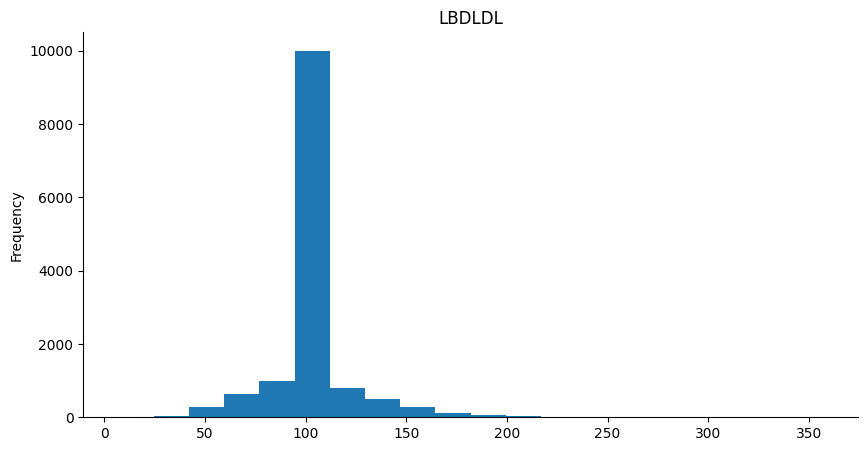

In [18]:
fig = plt.figure(figsize=(10, 5))
axes = fig.subplots(1, 1)
lab_data_cholesterol_fillna_mean['LBDLDL'].plot(kind='hist', bins=20, title='LBDLDL', ax=axes)
axes.spines[['top', 'right']].set_visible(False)
plt.show()

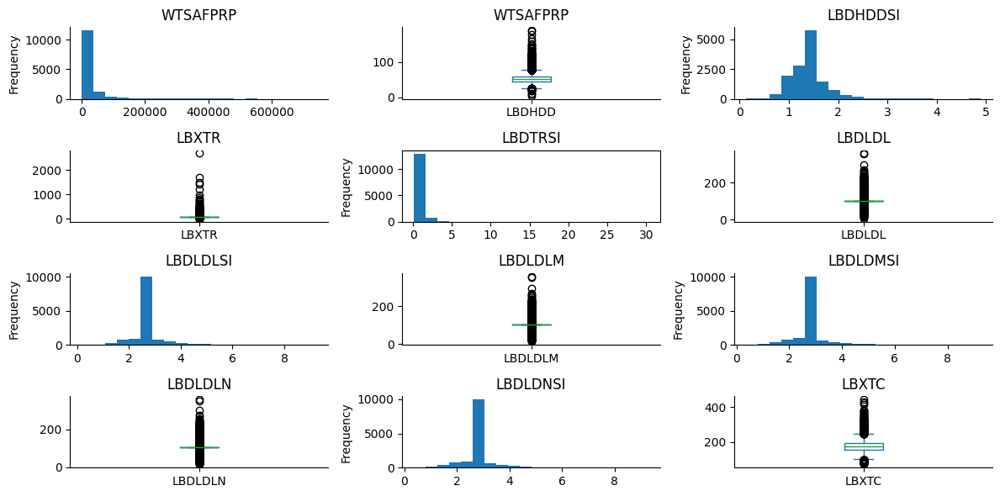

In [19]:
#lets see some plottings for some variables
import matplotlib.pyplot as plt
fig, axes = plt.subplots(4, 3, figsize=(12, 6))

lab_data_cholesterol_fillna_median['WTSAFPRP'].plot(kind='hist', bins=20, title='WTSAFPRP', ax=axes[0,0])
axes[0,0].spines[['top', 'right']].set_visible(False)

lab_data_cholesterol_fillna_median['LBDHDD'].plot(kind='box', title='WTSAFPRP', ax=axes[0,1])
axes[0,1].spines[['top', 'right']].set_visible(False)

lab_data_cholesterol_fillna_median['LBDHDDSI'].plot(kind='hist', bins=20, title='LBDHDDSI', ax=axes[0,2])
axes[0,2].spines[['top', 'right']].set_visible(False)

lab_data_cholesterol_fillna_median['LBXTR'].plot(kind='box', title='LBXTR', ax=axes[1,0])
axes[1,0].spines[['top', 'right']].set_visible(False)

lab_data_cholesterol_fillna_median['LBDTRSI'].plot(kind='hist', bins=20, title='LBDTRSI', ax=axes[1,1])
axes[1,1].spines[['top', 'right']].set

lab_data_cholesterol_fillna_median['LBDLDL'].plot(kind='box', title='LBDLDL', ax=axes[1,2])
axes[1,2].spines[['top', 'right']].set_visible(False)

lab_data_cholesterol_fillna_median['LBDLDLSI'].plot(kind='hist', bins=20, title='LBDLDLSI', ax=axes[2,0])
axes[2,0].spines[['top', 'right']].set_visible(False)

lab_data_cholesterol_fillna_median['LBDLDLM'].plot(kind='box', title='LBDLDLM', ax=axes[2,1])
axes[2,1].spines[['top', 'right']].set_visible(False)

lab_data_cholesterol_fillna_median['LBDLDMSI'].plot(kind='hist', bins=20, title='LBDLDMSI', ax=axes[2,2])
axes[2,2].spines[['top', 'right']].set_visible(False)

lab_data_cholesterol_fillna_median['LBDLDLN'].plot(kind='box', title='LBDLDLN', ax=axes[3,0])
axes[3,0].spines[['top', 'right']].set_visible(False)

lab_data_cholesterol_fillna_median['LBDLDNSI'].plot(kind='hist', bins=20, title='LBDLDNSI', ax=axes[3,1])
axes[3,1].spines[['top', 'right']].set_visible(False)

lab_data_cholesterol_fillna_median['LBXTC'].plot(kind='box', title='LBXTC', ax=axes[3,2])
axes[3,2].spines[['top', 'right']].set_visible(False)

plt.tight_layout()
plt.show()

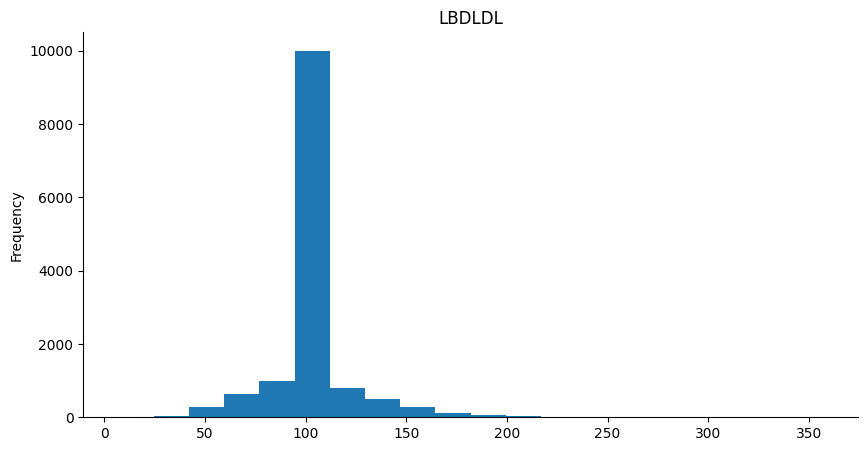

In [20]:
fig = plt.figure(figsize=(10, 5))
axes = fig.subplots(1, 1)
lab_data_cholesterol_fillna_median['LBDLDL'].plot(kind='hist', bins=20, title='LBDLDL', ax=axes)
axes.spines[['top', 'right']].set_visible(False)
plt.show()

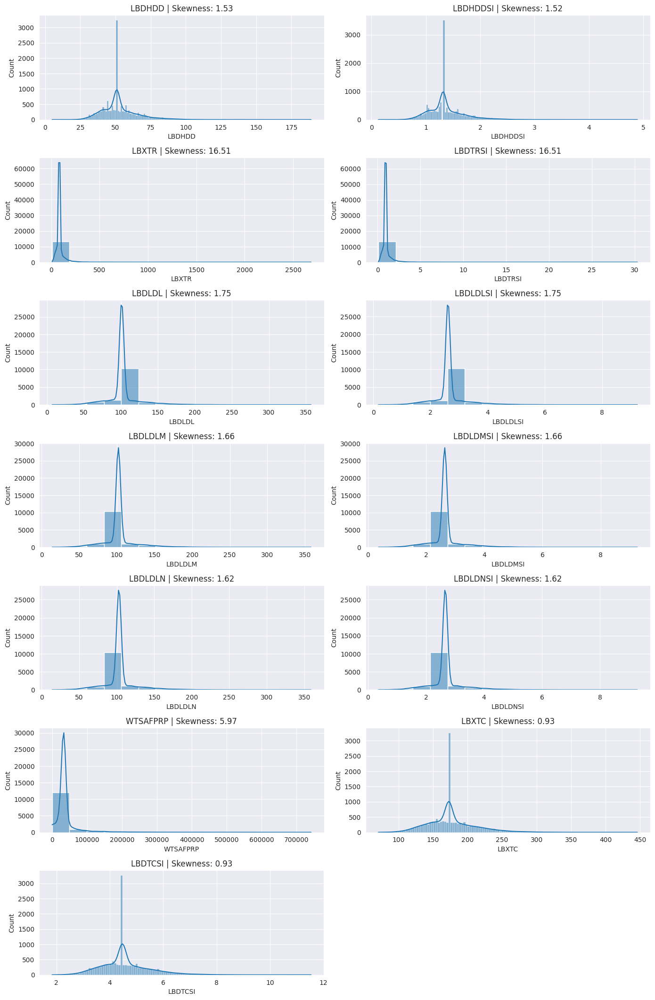

In [22]:
# Set Seaborn style
sns.set_style("darkgrid")

# Identify numerical columns
numerical_columns = lab_data_cholesterol_fillna_median.select_dtypes(include=["int64", "float64"]).columns

# Plot distribution of each numerical feature
plt.figure(figsize=(14, len(numerical_columns) * 3))
for idx, feature in enumerate(numerical_columns, 1):
    plt.subplot(len(numerical_columns), 2, idx)
    sns.histplot(lab_data_cholesterol_fillna_median[feature], kde=True)
    plt.title(f"{feature} | Skewness: {round(lab_data_cholesterol_fillna_median[feature].skew(), 2)}")

# Adjust layout and show plots
plt.tight_layout()
plt.show()

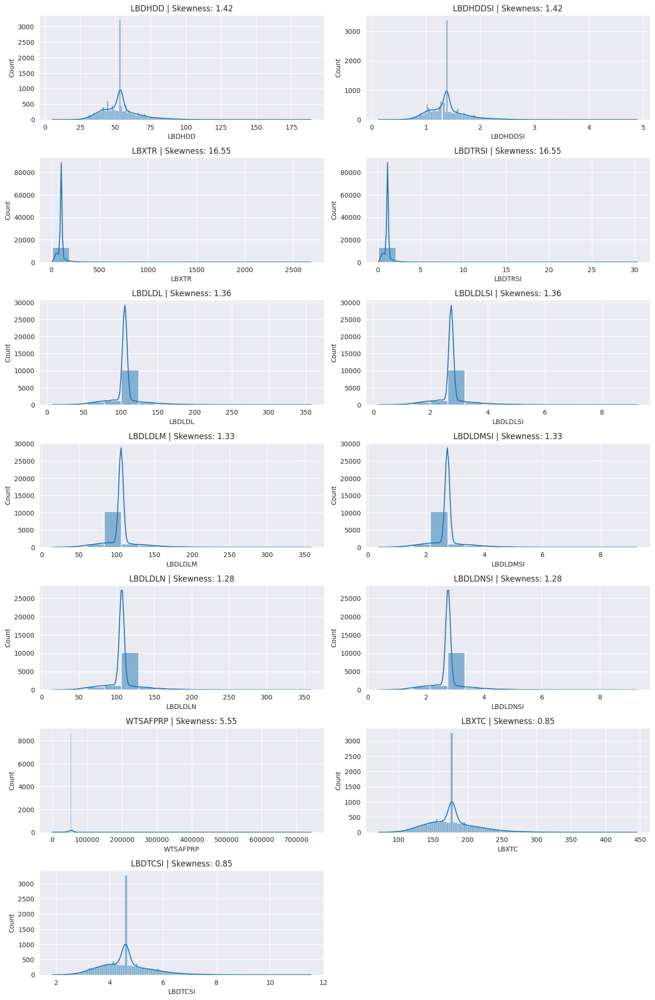

In [23]:
# Set Seaborn style
sns.set_style("darkgrid")

# Identify numerical columns
numerical_columns = lab_data_cholesterol_fillna_mean.select_dtypes(include=["int64", "float64"]).columns

# Plot distribution of each numerical feature
plt.figure(figsize=(14, len(numerical_columns) * 3))
for idx, feature in enumerate(numerical_columns, 1):
    plt.subplot(len(numerical_columns), 2, idx)
    sns.histplot(lab_data_cholesterol_fillna_mean[feature], kde=True)
    plt.title(f"{feature} | Skewness: {round(lab_data_cholesterol_fillna_mean[feature].skew(), 2)}")

# Adjust layout and show plots
plt.tight_layout()
plt.show()

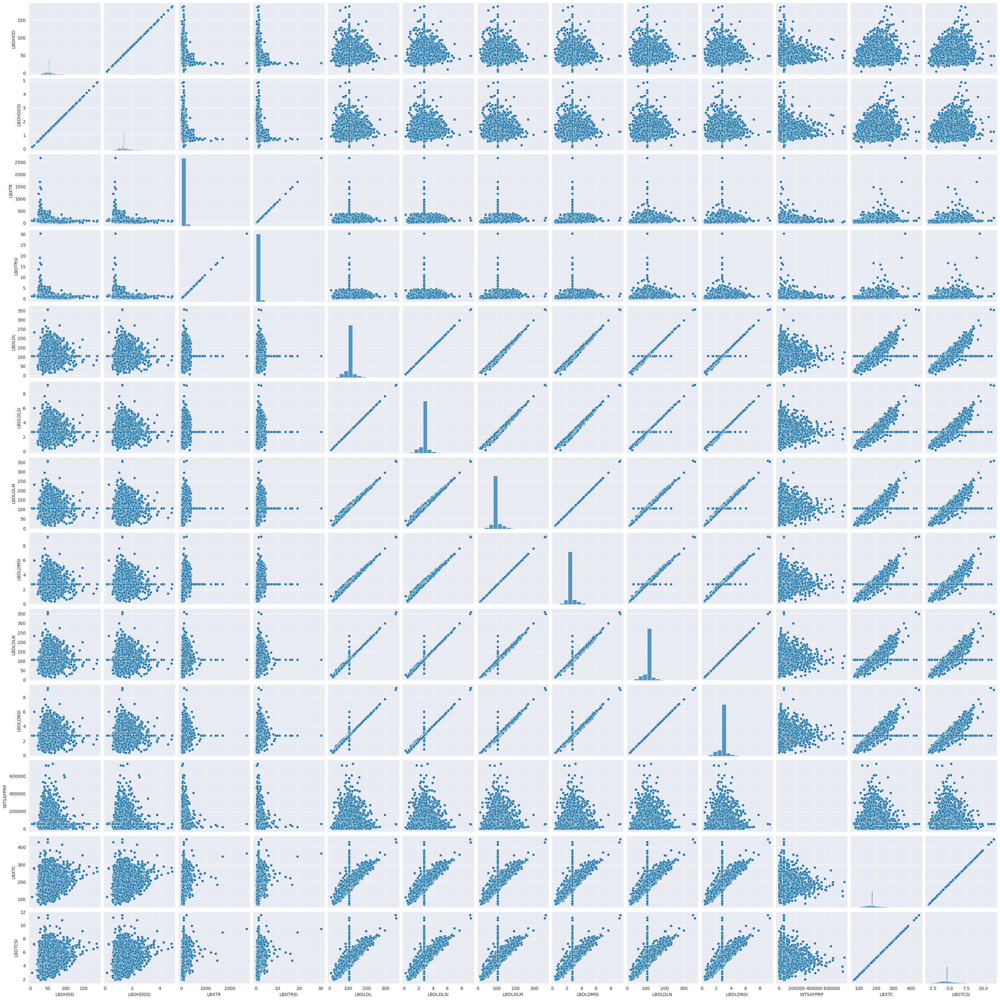

In [24]:
#lets see bevariate
sns.pairplot(lab_data_cholesterol_fillna_mean)

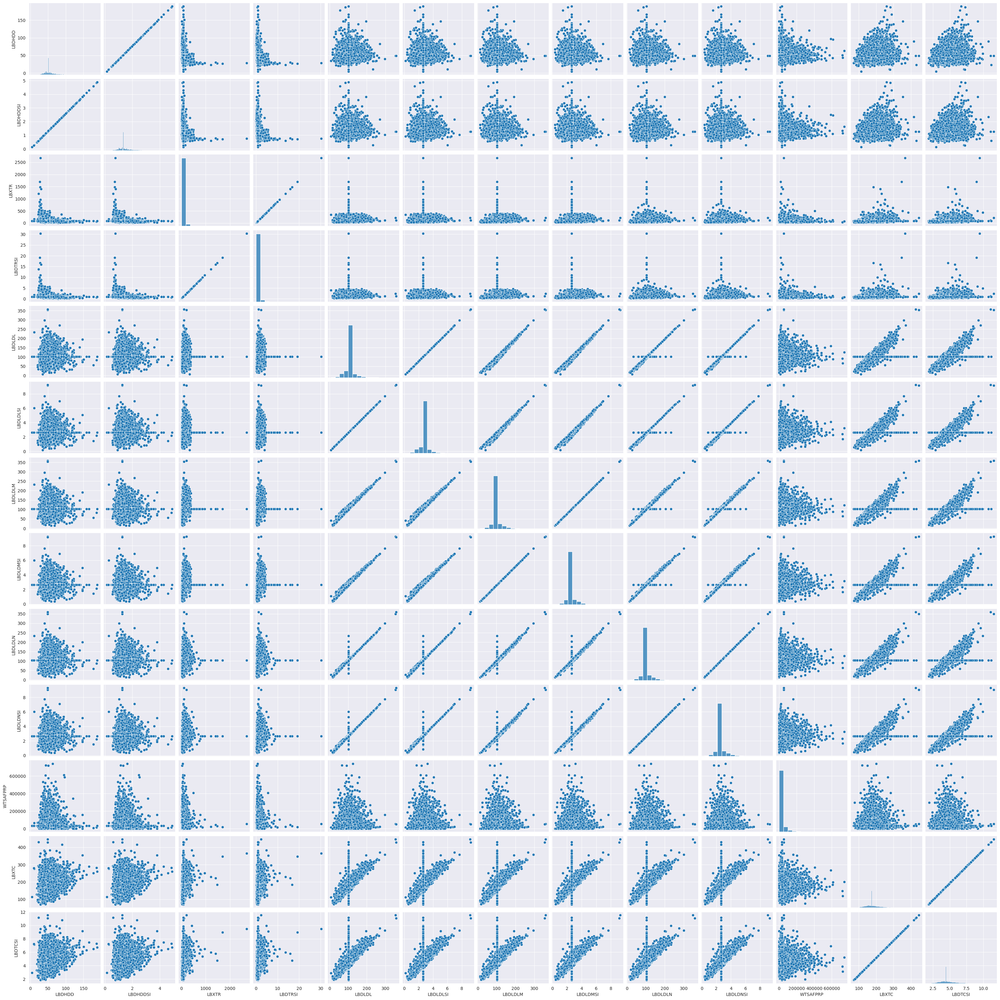

In [25]:
sns.pairplot(lab_data_cholesterol_fillna_median)

## PCA and Kmeans part

In [26]:
from sklearn.cluster import KMeans
clusters = 8

kmeans = KMeans(n_clusters = clusters)
kmeans.fit(lab_data_cholesterol_fillna_mean)

print(kmeans.labels_)

[1 5 1 ... 1 3 5]


In [27]:
from sklearn.cluster import KMeans
clusters = 8

kmeans1 = KMeans(n_clusters = clusters)
kmeans1.fit(lab_data_cholesterol_fillna_median)

print(kmeans1.labels_)

[0 0 0 ... 0 5 0]


In [28]:
from sklearn.decomposition import PCA

pca = PCA(3)
pca.fit(lab_data_cholesterol_fillna_mean)

pca_data = pd.DataFrame(pca.transform(lab_data_cholesterol_fillna_mean))

print(pca_data.head())

              0          1             2
0 -7.275958e-12   0.000000  5.684342e-14
1 -2.635079e+04 -71.733963  1.457594e+00
2 -7.275958e-12   0.000000  5.684342e-14
3  5.261067e-04   5.899981  1.111709e+01
4 -7.275958e-12   0.000000  5.684342e-14


In [29]:
from sklearn.decomposition import PCA

pca1 = PCA(3)
pca1.fit(lab_data_cholesterol_fillna_median)

pca_data1 = pd.DataFrame(pca1.transform(lab_data_cholesterol_fillna_median))

print(pca_data1.head())

              0          1          2
0  -7775.762697  -6.890170  -0.576354
1 -13087.692685 -58.147135  -2.507893
2  -7775.762697  -6.890170  -0.576354
3  -7775.761772   0.256996  13.590350
4  -7775.762697  -6.890170  -0.576354


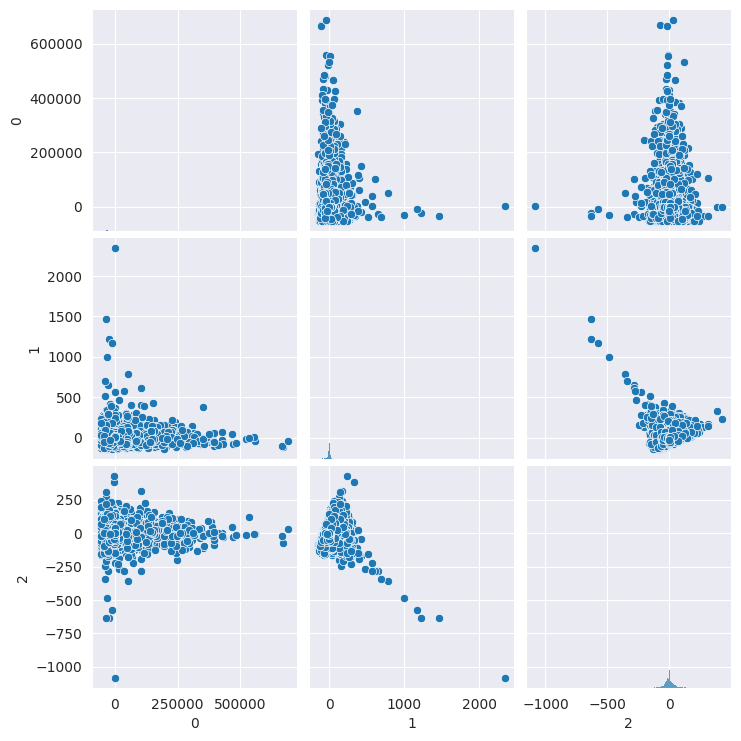

In [30]:
#Be variate see the PCA
sns.pairplot(pca_data)

<Axes: xlabel='0', ylabel='1'>

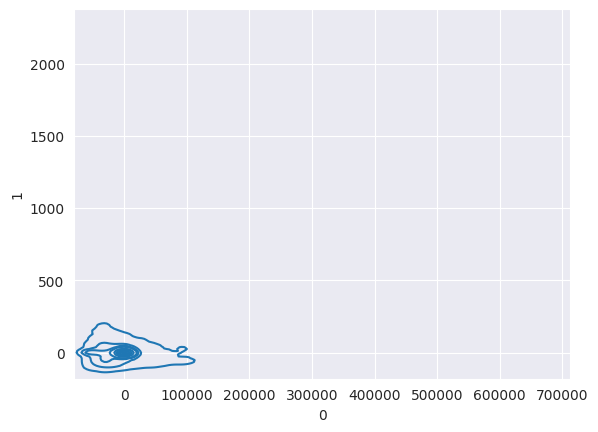

In [32]:
sns.kdeplot(data=pca_data, x=0, y=1)

<Axes: xlabel='0', ylabel='1'>

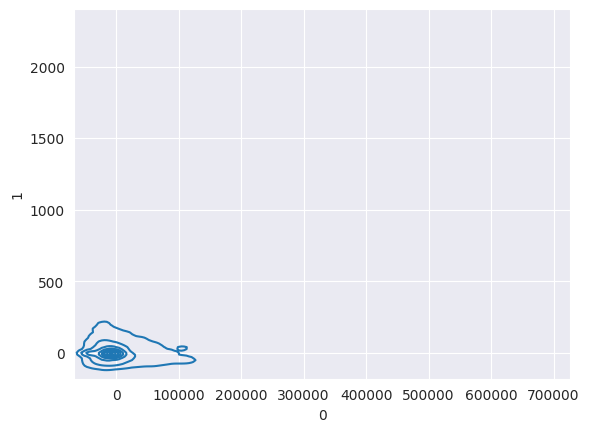

In [33]:
sns.kdeplot(data=pca_data1, x=0, y=1)

<Axes: ylabel='Density'>

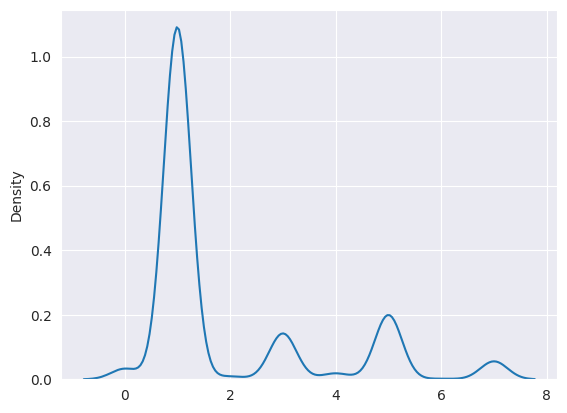

In [34]:
sns.kdeplot(data=kmeans.labels_)

<Axes: ylabel='Density'>

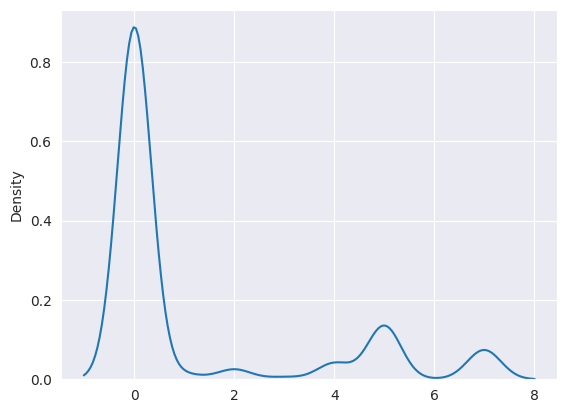

In [35]:
sns.kdeplot(data=kmeans1.labels_)

In [39]:
# prompt: xgboost

!pip install xgboost

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 153.9/153.9 MB 7.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 199.0/199.0 MB 5.4 MB/s eta 0:00:00


In [40]:
# prompt: xgboost model for lab_data_cholesterol fillna mean

import xgboost as xgb
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error

# Assuming 'lab_data_cholesterol_fillna_mean' is your DataFrame
# and  want to predict 'LBDLDL'

# Define features (X) and target (y)
X = lab_data_cholesterol_fillna_mean.drop('LBDLDL', axis=1)
y = lab_data_cholesterol_fillna_mean['LBDLDL']

# Split data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Initialize XGBoost regressor
model = xgb.XGBRegressor(objective='reg:squarederror', random_state=42)

# Train the model
model.fit(X_train, y_train)

# Make predictions
y_pred = model.predict(X_test)

# Evaluate the model
rmse = np.sqrt(mean_squared_error(y_test, y_pred))
print(f"Root Mean Squared Error: {rmse}")

Root Mean Squared Error: 0.20893450043278566


In [41]:
MAE = np.mean(np.abs(y_test - y_pred))
print(f"Mean Absolute Error (MAE): {MAE}")

Mean Absolute Error (MAE): 0.019891636899538025


In [42]:
MSE = np.mean((y_test - y_pred) ** 2)
print(f"Mean Squared Error (MSE): {MSE}")

Mean Squared Error (MSE): 0.04365362547109771


In [43]:
# prompt: all variable min max on lab_data_cholesterol_fillna_median
print("Min for every varible in Laboratory data filled in median:")
print(lab_data_cholesterol_fillna_median.min())
print("Max for every varible in Laboratory data filled in median:")
print(lab_data_cholesterol_fillna_median.max())

Min for every varible in Laboratory data filled in median:
LBDHDD      5.000000e+00
LBDHDDSI    1.300000e-01
LBXTR       1.000000e+01
LBDTRSI     1.130000e-01
LBDLDL      7.000000e+00
LBDLDLSI    1.810000e-01
LBDLDLM     1.400000e+01
LBDLDMSI    3.620000e-01
LBDLDLN     1.400000e+01
LBDLDNSI    3.620000e-01
WTSAFPRP    5.397605e-79
LBXTC       7.100000e+01
LBDTCSI     1.840000e+00
dtype: float64
Max for every varible in Laboratory data filled in median:
LBDHDD         189.000000
LBDHDDSI         4.890000
LBXTR         2684.000000
LBDTRSI         30.302000
LBDLDL         357.000000
LBDLDLSI         9.232000
LBDLDLM        358.000000
LBDLDMSI         9.258000
LBDLDLN        359.000000
LBDLDNSI         9.284000
WTSAFPRP    741259.188749
LBXTC          446.000000
LBDTCSI         11.530000
dtype: float64


In [44]:
# prompt: xgboost model for lab_data_cholesterol fillna mean

import xgboost as xgb
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error

# Assuming 'lab_data_cholesterol_fillna_mean' is your DataFrame
# and  want to predict 'LBDLDL'

# Define features (X) and target (y)
X = lab_data_cholesterol_fillna_median.drop('LBDLDL', axis=1)
y = lab_data_cholesterol_fillna_median['LBDLDL']

# Split data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Initialize XGBoost regressor
model = xgb.XGBRegressor(objective='reg:squarederror', random_state=42)

# Train the model
model.fit(X_train, y_train)

# Make predictions
y_pred = model.predict(X_test)

# Evaluate the model
rmse = np.sqrt(mean_squared_error(y_test, y_pred))
print(f"Root Mean Squared Error: {rmse}")

Root Mean Squared Error: 0.20934750231876256


In [45]:
MAE = np.mean(np.abs(y_test - y_pred))
print(f"Mean Absolute Error (MAE): {MAE}")

Mean Absolute Error (MAE): 0.01913115956605887


In [46]:
MSE = np.mean((y_test - y_pred) ** 2)
print(f"Mean Squared Error (MSE): {MSE}")

Mean Squared Error (MSE): 0.0438263767271043


In [47]:
# prompt: all variable min max on lab_data_cholesterol_fillna_mean
print("Min for every varible in Laboratory data filled in mean:")
print(lab_data_cholesterol_fillna_mean.min())
print("Max for every varible in Laboratory data filled in mean:")
print(lab_data_cholesterol_fillna_mean.max())

Min for every varible in Laboratory data filled in mean:
LBDHDD      5.000000e+00
LBDHDDSI    1.300000e-01
LBXTR       1.000000e+01
LBDTRSI     1.130000e-01
LBDLDL      7.000000e+00
LBDLDLSI    1.810000e-01
LBDLDLM     1.400000e+01
LBDLDMSI    3.620000e-01
LBDLDLN     1.400000e+01
LBDLDNSI    3.620000e-01
WTSAFPRP    5.397605e-79
LBXTC       7.100000e+01
LBDTCSI     1.840000e+00
dtype: float64
Max for every varible in Laboratory data filled in mean:
LBDHDD         189.000000
LBDHDDSI         4.890000
LBXTR         2684.000000
LBDTRSI         30.302000
LBDLDL         357.000000
LBDLDLSI         9.232000
LBDLDLM        358.000000
LBDLDMSI         9.258000
LBDLDLN        359.000000
LBDLDNSI         9.284000
WTSAFPRP    741259.188749
LBXTC          446.000000
LBDTCSI         11.530000
dtype: float64


In [48]:
lab_data_cholesterol_fillna_median.to_csv('/content/Lab_Chol_Fill_median.csv')
lab_data_cholesterol_fillna_mean.to_csv('/content/Lab_Chol_Fill_mean.csv')

## Lets see the blood analysis and do sam feature enginnering as it cam contain inofrmation for blood pressure

In [49]:
blood_analysis = ["LBXWBCSI","LBXLYPCT","LBXMOPCT","LBXNEPCT","LBXEOPCT","LBXBAPCT","LBXRBCSI","LBXHGB","LBXHCT","LBXMCVSI","LBXMC","LBXMCHSI","LBXRDW","LBXPLTSI","LBXMPSI","LBXNRBC","LBDLYMNO","LBDMONO","LBDNENO","LBDEONO","LBDBANO"]
lab_blood_analysis = lab_data[blood_analysis]
lab_blood_analysis.head()

,LBXWBCSI,LBXLYPCT,LBXMOPCT,LBXNEPCT,LBXEOPCT,LBXBAPCT,LBXRBCSI,LBXHGB,LBXHCT,LBXMCVSI,...,LBXMCHSI,LBXRDW,LBXPLTSI,LBXMPSI,LBXNRBC,LBDLYMNO,LBDMONO,LBDNENO,LBDEONO,LBDBANO
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,4.5,45.6,6.2,46.4,1.4,0.5,4.80,13.7,40.5,84.3,...,28.4,13.1,263.0,8.2,0.1,2.1,0.3,2.1,0.1,5.397605e-79
2,9.5,46.4,10.9,39.2,2.9,0.7,4.50,12.6,36.6,81.2,...,27.9,13.1,286.0,6.6,0.1,4.4,1.0,3.7,0.3,1.000000e-01
3,7.8,34.5,6.0,58.3,0.8,0.5,4.35,12.3,36.5,83.7,...,28.1,14.0,314.0,6.9,0.1,2.7,0.5,4.5,0.1,5.397605e-79
4,9.1,38.3,7.8,48.8,4.1,1.1,4.21,11.7,33.5,79.6,...,27.8,13.4,287.0,6.9,0.1,3.5,0.7,4.4,0.4,1.000000e-01


In [50]:
#lets see the info
lab_blood_analysis.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 13772 entries, 0 to 13771
Data columns (total 21 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   LBXWBCSI  12156 non-null  float64
 1   LBXLYPCT  12151 non-null  float64
 2   LBXMOPCT  12151 non-null  float64
 3   LBXNEPCT  12151 non-null  float64
 4   LBXEOPCT  12151 non-null  float64
 5   LBXBAPCT  12151 non-null  float64
 6   LBXRBCSI  12156 non-null  float64
 7   LBXHGB    12156 non-null  float64
 8   LBXHCT    12156 non-null  float64
 9   LBXMCVSI  12156 non-null  float64
 10  LBXMC     12156 non-null  float64
 11  LBXMCHSI  12156 non-null  float64
 12  LBXRDW    12156 non-null  float64
 13  LBXPLTSI  12156 non-null  float64
 14  LBXMPSI   12156 non-null  float64
 15  LBXNRBC   12151 non-null  float64
 16  LBDLYMNO  12151 non-null  float64
 17  LBDMONO   12151 non-null  float64
 18  LBDNENO   12151 non-null  float64
 19  LBDEONO   12151 non-null  float64
 20  LBDBANO   12151 non-null  fl

In [51]:
#lets come with varibale couterparts as describing
lab_blood_analysis.describe()

,LBXWBCSI,LBXLYPCT,LBXMOPCT,LBXNEPCT,LBXEOPCT,LBXBAPCT,LBXRBCSI,LBXHGB,LBXHCT,LBXMCVSI,...,LBXMCHSI,LBXRDW,LBXPLTSI,LBXMPSI,LBXNRBC,LBDLYMNO,LBDMONO,LBDNENO,LBDEONO,LBDBANO
count,12156.000000,12151.000000,12151.000000,12151.000000,1.215100e+04,12151.000000,12156.000000,12156.000000,12156.000000,12156.000000,...,12156.000000,12156.000000,12156.000000,12156.000000,1.215100e+04,12151.000000,12151.000000,12151.000000,1.215100e+04,1.215100e+04
mean,7.277879,34.002321,8.170348,54.215752,2.967854e+00,0.767805,4.719570,13.701324,40.762636,86.624852,...,29.105397,13.802706,262.641247,8.116905,8.219900e-02,2.444976,0.578298,3.998395,2.119826e-01,5.037445e-02
std,4.245162,10.648916,2.203852,11.353330,2.339984e+00,0.327679,0.478204,1.524745,4.192221,6.573466,...,2.553320,1.313348,72.548337,0.919438,9.228674e-02,3.454791,0.207026,1.713577,1.857418e-01,5.162049e-02
min,1.900000,3.100000,0.700000,8.400000,5.397605e-79,0.100000,2.320000,5.400000,21.100000,35.400000,...,10.200000,11.300000,8.000000,5.400000,5.397605e-79,0.200000,0.100000,0.400000,5.397605e-79,5.397605e-79
25%,5.700000,26.600000,6.700000,47.400000,1.500000e+00,0.500000,4.400000,12.700000,37.900000,82.900000,...,27.800000,13.000000,213.000000,7.500000,5.397605e-79,1.800000,0.400000,2.800000,1.000000e-01,5.397605e-79
50%,6.900000,33.000000,7.900000,55.200000,2.300000e+00,0.700000,4.700000,13.600000,40.600000,87.200000,...,29.400000,13.500000,254.000000,8.000000,1.000000e-01,2.200000,0.500000,3.700000,2.000000e-01,5.397605e-79
75%,8.400000,40.100000,9.300000,62.100000,3.700000e+00,0.900000,5.010000,14.700000,43.600000,90.900000,...,30.800000,14.200000,304.000000,8.700000,1.000000e-01,2.800000,0.700000,4.900000,3.000000e-01,1.000000e-01
max,400.000000,89.700000,57.200000,92.800000,2.910000e+01,4.800000,7.970000,19.900000,58.800000,114.600000,...,39.800000,36.500000,1021.000000,13.000000,3.000000e+00,358.800000,6.700000,35.200000,3.800000e+00,5.000000e-01


In [52]:
#Mising Values
lab_blood_analysis.isnull().sum()

,0
LBXWBCSI,1616
LBXLYPCT,1621
LBXMOPCT,1621
LBXNEPCT,1621
LBXEOPCT,1621
LBXBAPCT,1621
LBXRBCSI,1616
LBXHGB,1616
LBXHCT,1616
LBXMCVSI,1616


In [53]:
#percentage of missing value
lab_blood_analysis_percent_missing = lab_blood_analysis.isnull().sum() * 100 / len(lab_blood_analysis)
lab_blood_analysis_percent_missing

,0
LBXWBCSI,11.733953
LBXLYPCT,11.770258
LBXMOPCT,11.770258
LBXNEPCT,11.770258
LBXEOPCT,11.770258
LBXBAPCT,11.770258
LBXRBCSI,11.733953
LBXHGB,11.733953
LBXHCT,11.733953
LBXMCVSI,11.733953


As we can see it's not so much as it is 11,8% lets fill with mean,median of the varibales and go to whole set as mean and whole as median and see what will come

In [54]:
#Fillna with mean
lab_blood_analysis_fillna_mean = lab_blood_analysis.fillna(lab_blood_analysis.mean())

In [55]:
#Median
lab_blood_analysis_fillna_median = lab_blood_analysis.fillna(lab_blood_analysis.median())

Lets see some plotting

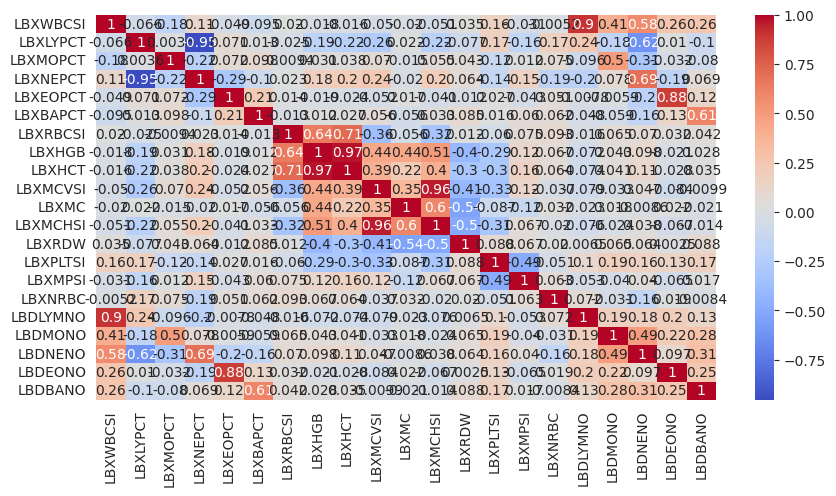

In [62]:
fig = plt.figure(figsize=(10, 5))
sns.heatmap(lab_blood_analysis_fillna_mean.corr(), annot=True,  cmap='coolwarm')
plt.show()

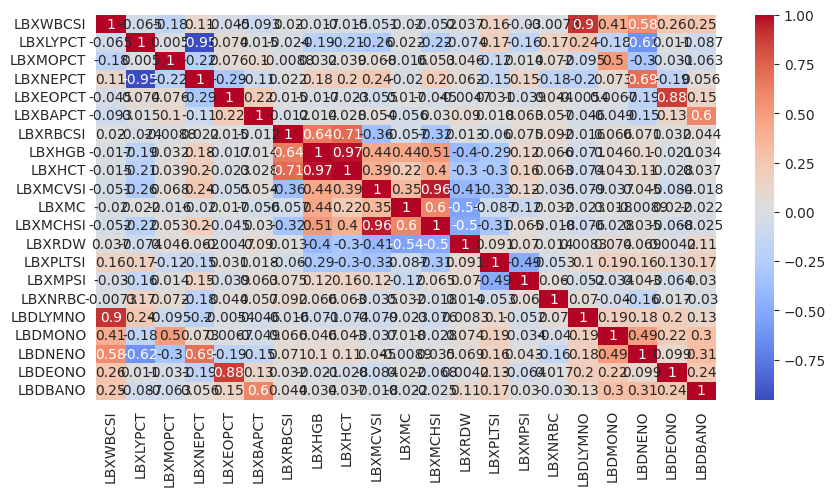

In [63]:
fig = plt.figure(figsize=(10, 5))
sns.heatmap(lab_blood_analysis_fillna_median.corr(), annot=True, cmap='coolwarm')
plt.show()

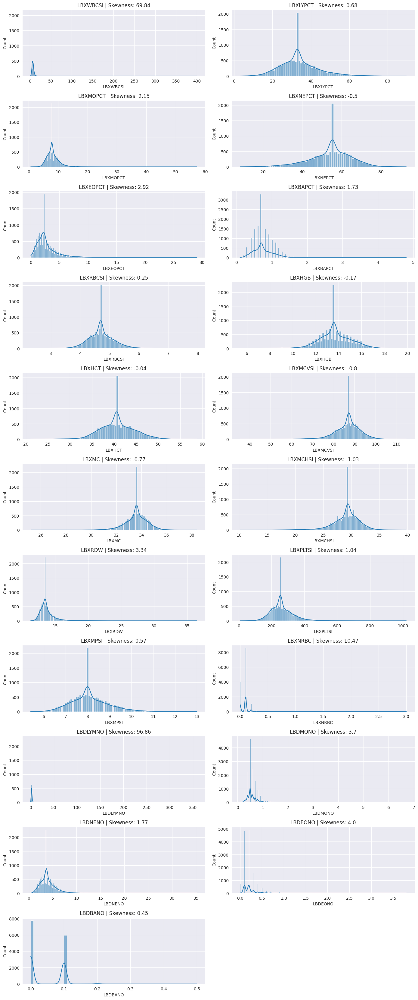

In [65]:
# Set Seaborn style
sns.set_style("darkgrid")

# Identify numerical columns
numerical_columns = lab_blood_analysis_fillna_median.select_dtypes(include=["int64", "float64"]).columns

# Plot distribution of each numerical feature
plt.figure(figsize=(14, len(numerical_columns) * 3))
for idx, feature in enumerate(numerical_columns, 1):
    plt.subplot(len(numerical_columns), 2, idx)
    sns.histplot(lab_blood_analysis_fillna_median[feature], kde=True)
    plt.title(f"{feature} | Skewness: {round(lab_blood_analysis_fillna_median[feature].skew(), 2)}")

# Adjust layout and show plots
plt.tight_layout()
plt.show()

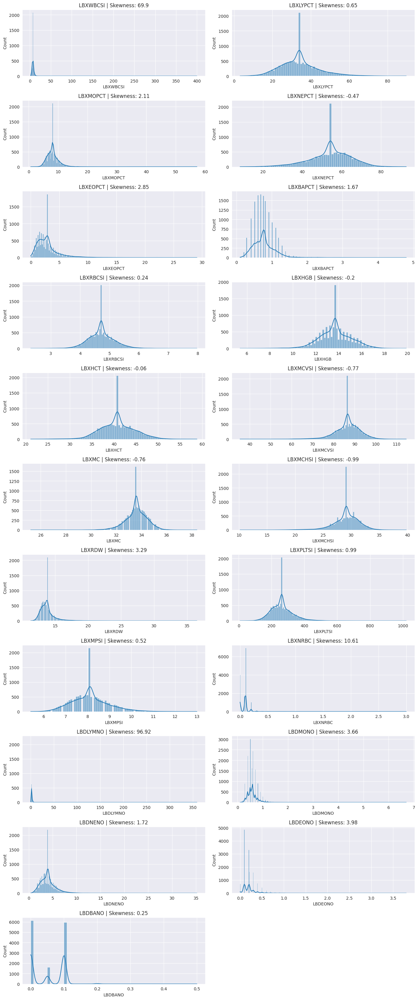

In [66]:
# Set Seaborn style
sns.set_style("darkgrid")

# Identify numerical columns
numerical_columns = lab_blood_analysis_fillna_mean.select_dtypes(include=["int64", "float64"]).columns

# Plot distribution of each numerical feature
plt.figure(figsize=(14, len(numerical_columns) * 3))
for idx, feature in enumerate(numerical_columns, 1):
    plt.subplot(len(numerical_columns), 2, idx)
    sns.histplot(lab_blood_analysis_fillna_mean[feature], kde=True)
    plt.title(f"{feature} | Skewness: {round(lab_blood_analysis_fillna_mean[feature].skew(), 2)}")

# Adjust layout and show plots
plt.tight_layout()
plt.show()

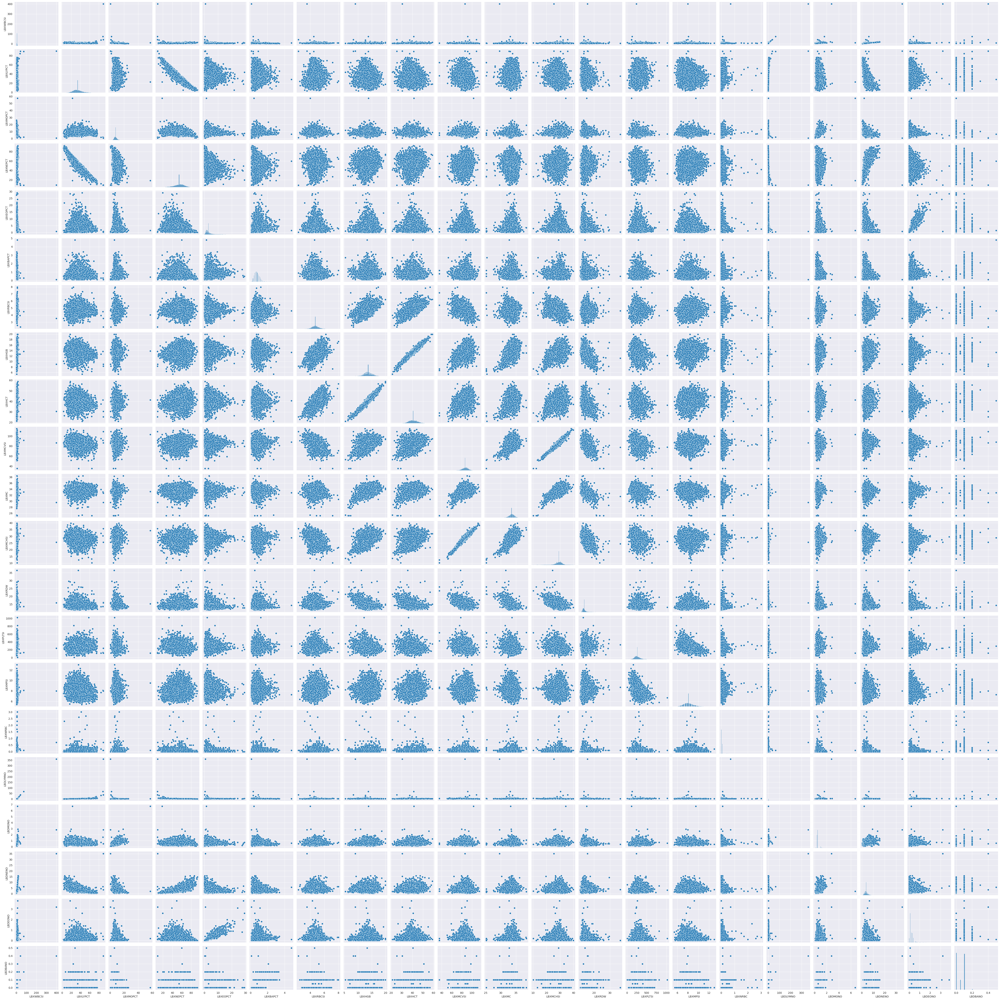

In [67]:
sns.pairplot(lab_blood_analysis_fillna_mean)

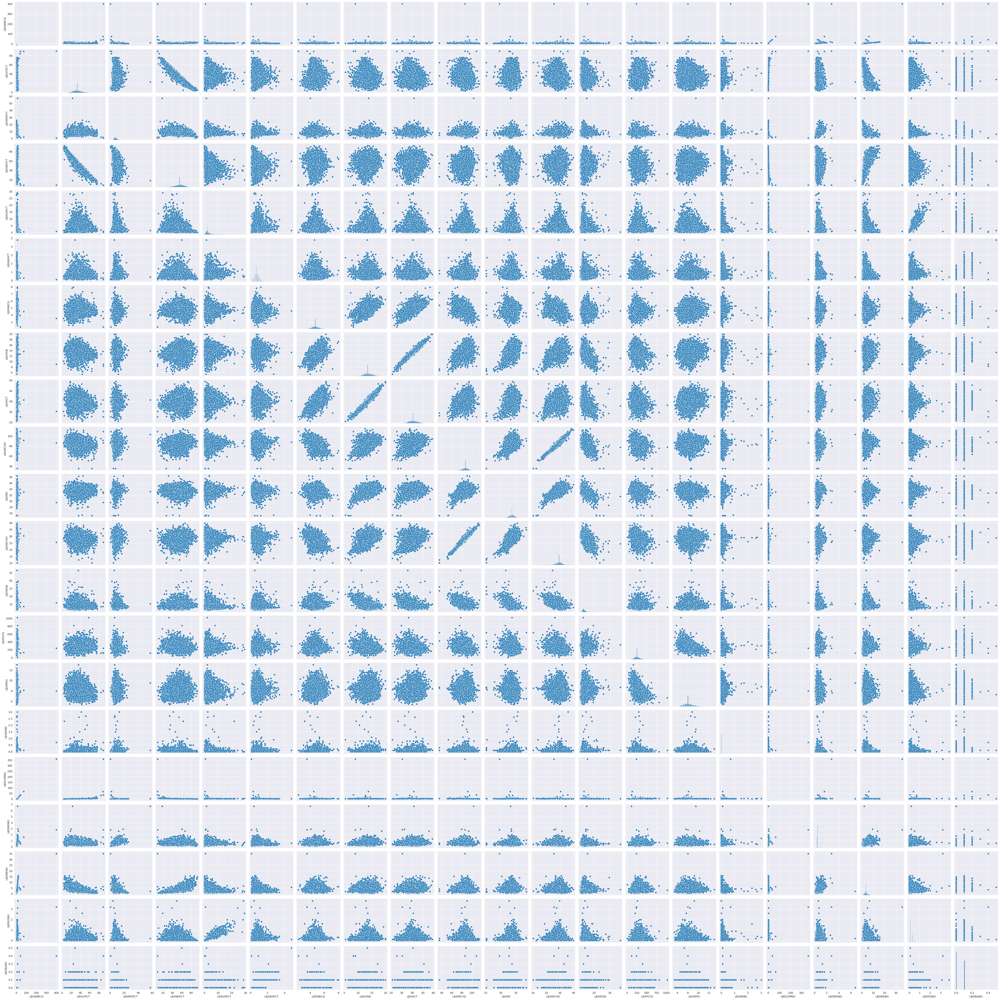

In [68]:
sns.pairplot(lab_blood_analysis_fillna_median)

PCA and KMEANS


In [79]:
from sklearn.cluster import KMeans
clusters = 8

kmeans2 = KMeans(n_clusters = clusters)
kmeans2.fit(lab_blood_analysis_fillna_mean)

print(kmeans2.labels_)

[4 4 2 ... 2 6 3]


In [80]:
from sklearn.cluster import KMeans
clusters = 8

kmeans3 = KMeans(n_clusters = clusters)
kmeans3.fit(lab_blood_analysis_fillna_median)

print(kmeans3.labels_)

[5 5 1 ... 1 7 0]


In [71]:
from sklearn.decomposition import PCA

pca2 = PCA(3)
pca2.fit(lab_blood_analysis_fillna_mean)

pca_data2 = pd.DataFrame(pca2.transform(lab_blood_analysis_fillna_mean))

print(pca_data2.head())

              0             1             2
0  5.684342e-14 -7.105427e-15 -1.421085e-14
1  9.027945e-01 -1.384283e+01 -6.396403e-01
2  2.429429e+01 -1.920188e+01 -3.217896e+00
3  5.140570e+01  4.193043e+00 -3.050572e+00
4  2.496324e+01 -7.023989e+00 -7.117891e+00


In [72]:
from sklearn.decomposition import PCA

pca3 = PCA(3)
pca3.fit(lab_blood_analysis_fillna_median)

pca_data3 = pd.DataFrame(pca3.transform(lab_blood_analysis_fillna_median))

print(pca_data3.head())

           0          1         2
0  -7.680814   0.972763  0.132946
1   1.926471 -13.970912 -0.654616
2  25.319837 -19.326712 -3.233782
3  52.425274   4.076466 -3.065360
4  25.985850  -7.148010 -7.133551


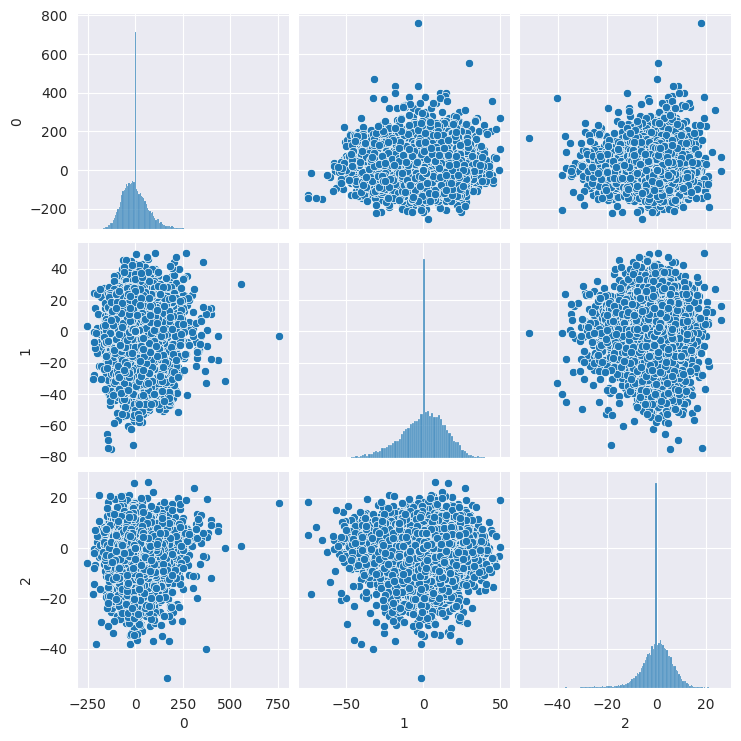

In [73]:
sns.pairplot(pca_data2)

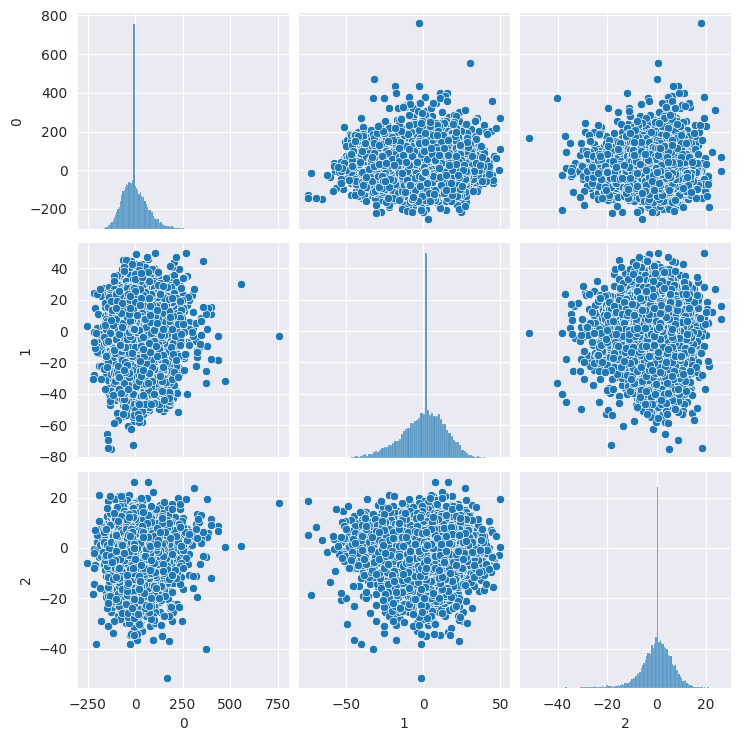

In [74]:
sns.pairplot(pca_data3)

<Axes: xlabel='0', ylabel='1'>

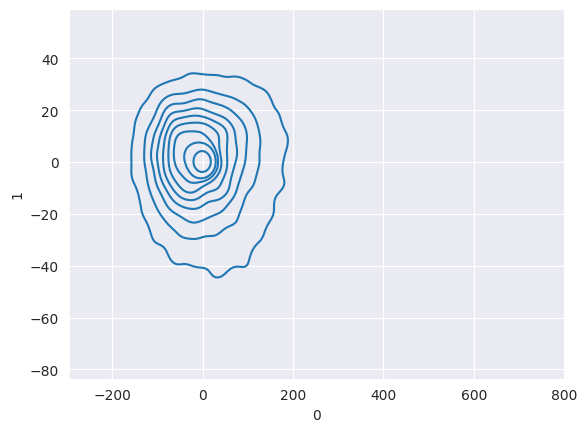

In [77]:
sns.kdeplot(data=pca_data2, x=0, y=1)

<Axes: xlabel='0', ylabel='1'>

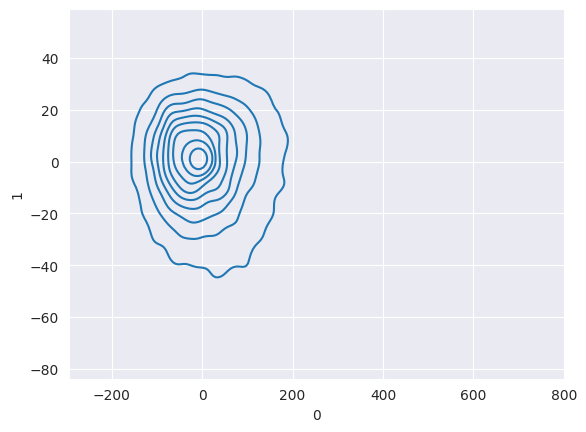

In [78]:
sns.kdeplot(data=pca_data3, x=0, y=1)

<Axes: ylabel='Density'>

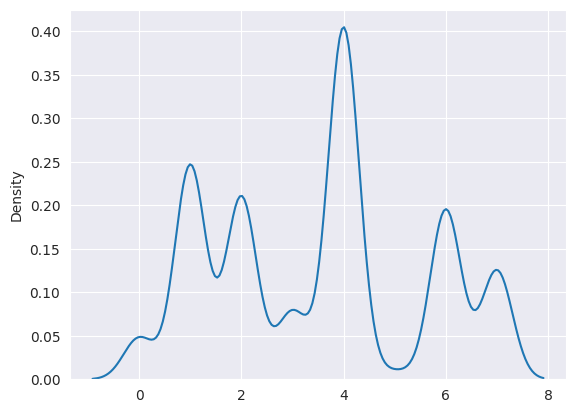

In [81]:
sns.kdeplot(data=kmeans2.labels_)

<Axes: ylabel='Density'>

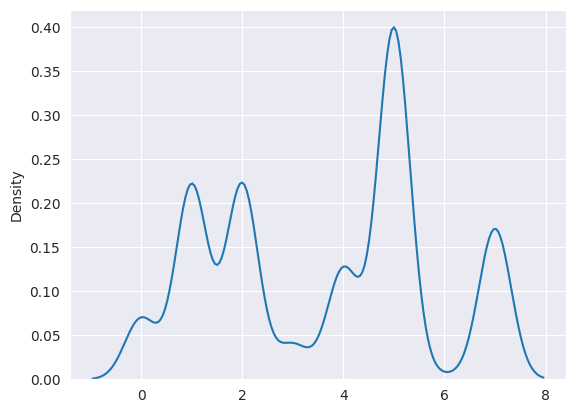

In [82]:
sns.kdeplot(data=kmeans3.labels_)

In [83]:
# prompt: min max variables for lab_blood_analysis_fillna_mean and  lab_blood_analysis_fillna_median

print("Min for every varible in Laboratory blood analysis data filled in median:")
print(lab_blood_analysis_fillna_median.min())
print("Max for every varible in Laboratory blood analysis data filled in median:")
print(lab_blood_analysis_fillna_median.max())

print("Min for every varible in Laboratory blood analysis data filled in mean:")
print(lab_blood_analysis_fillna_mean.min())
print("Max for every varible in Laboratory blood analysis data filled in mean:")
print(lab_blood_analysis_fillna_mean.max())

Min for every varible in Laboratory blood analysis data filled in median:
LBXWBCSI    1.900000e+00
LBXLYPCT    3.100000e+00
LBXMOPCT    7.000000e-01
LBXNEPCT    8.400000e+00
LBXEOPCT    5.397605e-79
LBXBAPCT    1.000000e-01
LBXRBCSI    2.320000e+00
LBXHGB      5.400000e+00
LBXHCT      2.110000e+01
LBXMCVSI    3.540000e+01
LBXMC       2.520000e+01
LBXMCHSI    1.020000e+01
LBXRDW      1.130000e+01
LBXPLTSI    8.000000e+00
LBXMPSI     5.400000e+00
LBXNRBC     5.397605e-79
LBDLYMNO    2.000000e-01
LBDMONO     1.000000e-01
LBDNENO     4.000000e-01
LBDEONO     5.397605e-79
LBDBANO     5.397605e-79
dtype: float64
Max for every varible in Laboratory blood analysis data filled in median:
LBXWBCSI     400.00
LBXLYPCT      89.70
LBXMOPCT      57.20
LBXNEPCT      92.80
LBXEOPCT      29.10
LBXBAPCT       4.80
LBXRBCSI       7.97
LBXHGB        19.90
LBXHCT        58.80
LBXMCVSI     114.60
LBXMC         38.40
LBXMCHSI      39.80
LBXRDW        36.50
LBXPLTSI    1021.00
LBXMPSI       13.00
LBXNRBC     

In [84]:

import xgboost as xgb
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error

# Assuming 'lab_blood_analysis_fillna_median' is your DataFrame
# and  to predict 'LBXHGB'

# Define features (X) and target (y)
X = lab_blood_analysis_fillna_median.drop('LBXHGB', axis=1)
y = lab_blood_analysis_fillna_median['LBXHGB']

# Split data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Initialize XGBoost regressor
model = xgb.XGBRegressor(objective='reg:squarederror', random_state=42)

# Train the model
model.fit(X_train, y_train)

# Make predictions
y_pred = model.predict(X_test)

# Evaluate the model
rmse = np.sqrt(mean_squared_error(y_test, y_pred))
print(f"Root Mean Squared Error: {rmse}")
MAE = np.mean(np.abs(y_test - y_pred))
print(f"Mean Absolute Error (MAE): {MAE}")
MSE = np.mean((y_test - y_pred) ** 2)
print(f"Mean Squared Error (MSE): {MSE}")

Root Mean Squared Error: 0.07482351958104924
Mean Absolute Error (MAE): 0.04334722480843162
Mean Squared Error (MSE): 0.005598559082495658


In [85]:

import xgboost as xgb
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error

# Assuming 'lab_blood_analysis_fillna_mean' is your DataFrame
# and  to predict 'LBXHGB'

# Define features (X) and target (y)
X = lab_blood_analysis_fillna_mean.drop('LBXHGB', axis=1)
y = lab_blood_analysis_fillna_mean['LBXHGB']

# Split data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Initialize XGBoost regressor
model = xgb.XGBRegressor(objective='reg:squarederror', random_state=42)

# Train the model
model.fit(X_train, y_train)

# Make predictions
y_pred = model.predict(X_test)

# Evaluate the model
rmse = np.sqrt(mean_squared_error(y_test, y_pred))
print(f"Root Mean Squared Error: {rmse}")
MAE = np.mean(np.abs(y_test - y_pred))
print(f"Mean Absolute Error (MAE): {MAE}")
MSE = np.mean((y_test - y_pred) ** 2)
print(f"Mean Squared Error (MSE): {MSE}")

Root Mean Squared Error: 0.07501511562592113
Mean Absolute Error (MAE): 0.04317639445374672
Mean Squared Error (MSE): 0.005627267572370316


In [86]:
lab_blood_analysis_fillna_median.to_csv('/content/drive/MyDrive/Lab_Blood_Fill_median.csv')
lab_blood_analysis_fillna_mean.to_csv('/content/drive/MyDrive/Lab_Blood_Fill_mean.csv')

In [88]:
c_pretain = ['LBXHSCRP','LBDHRPLC']
lab_data_c_pretain = lab_data[c_pretain]
lab_data_c_pretain.head()

,LBXHSCRP,LBDHRPLC
0,NaN,NaN
1,0.11,1.000000e+00
2,0.31,5.397605e-79
3,0.72,5.397605e-79
4,0.73,5.397605e-79


In [89]:
lab_data_c_pretain.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 13772 entries, 0 to 13771
Data columns (total 2 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   LBXHSCRP  11614 non-null  float64
 1   LBDHRPLC  11614 non-null  float64
dtypes: float64(2)
memory usage: 215.3 KB


In [90]:
lab_data_c_pretain.describe()

,LBXHSCRP,LBDHRPLC
count,11614.000000,1.161400e+04
mean,3.422093,3.426899e-02
std,7.792654,1.819271e-01
min,0.110000,5.397605e-79
25%,0.520000,5.397605e-79
50%,1.320000,5.397605e-79
75%,3.620000,5.397605e-79
max,246.860000,1.000000e+00


In [91]:
lab_data_c_pretain.isnull().sum()

,0
LBXHSCRP,2158
LBDHRPLC,2158


In [92]:
lab_data_c_pretain_percent_missing = lab_data_c_pretain.isnull().sum() * 100 / len(lab_data_c_pretain)
lab_data_c_pretain_percent_missing

,0
LBXHSCRP,15.669474
LBDHRPLC,15.669474


In [93]:
lab_data_c_pretain_fillna_mean = lab_data_c_pretain.fillna(lab_data_c_pretain.mean())
lab_data_c_pretain_fillna_median = lab_data_c_pretain.fillna(lab_data_c_pretain.median())


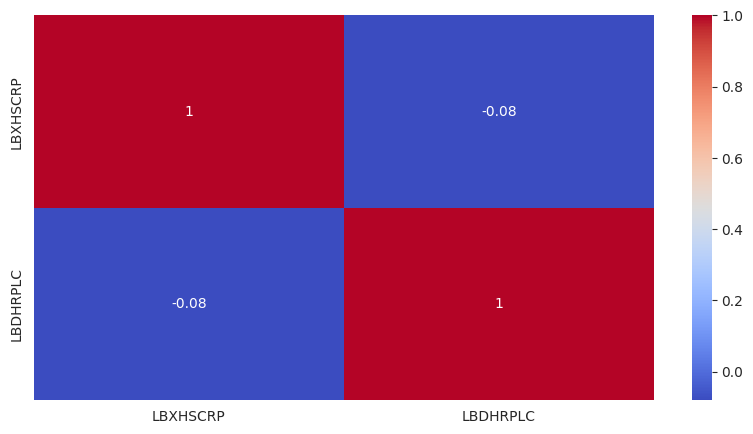

In [94]:
fig = plt.figure(figsize=(10, 5))
sns.heatmap(lab_data_c_pretain_fillna_mean.corr(), annot=True,  cmap='coolwarm')
plt.show()

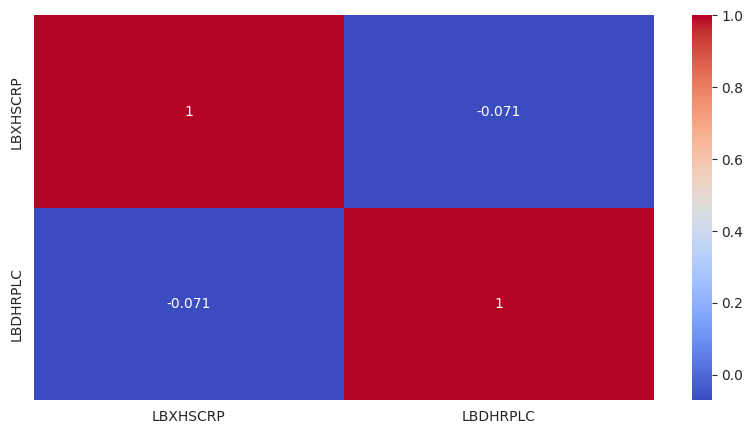

In [95]:
fig = plt.figure(figsize=(10, 5))
sns.heatmap(lab_data_c_pretain_fillna_median.corr(), annot=True, cmap='coolwarm')
plt.show()

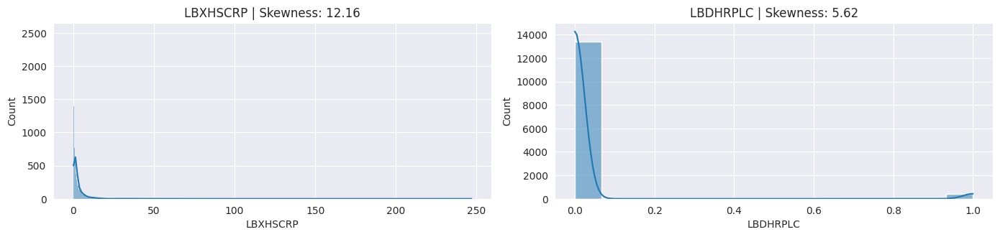

In [98]:
# Set Seaborn style
sns.set_style("darkgrid")

# Identify numerical columns
numerical_columns = lab_data_c_pretain_fillna_median.select_dtypes(include=["int64", "float64"]).columns

# Plot distribution of each numerical feature
plt.figure(figsize=(14, len(numerical_columns) * 3))
for idx, feature in enumerate(numerical_columns, 1):
    plt.subplot(len(numerical_columns), 2, idx)
    sns.histplot(lab_data_c_pretain_fillna_median[feature], kde=True)
    plt.title(f"{feature} | Skewness: {round(lab_data_c_pretain_fillna_median[feature].skew(), 2)}")

# Adjust layout and show plots
plt.tight_layout()
plt.show()

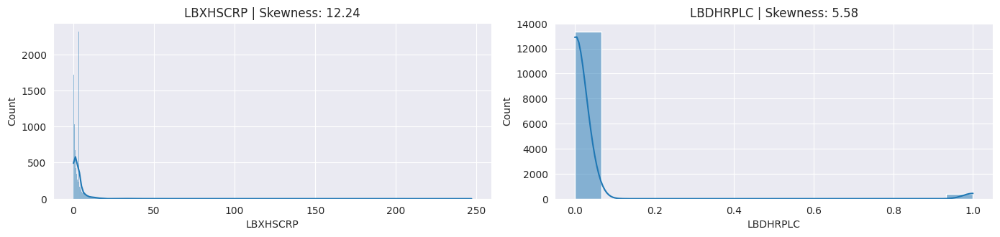

In [99]:
# Set Seaborn style
sns.set_style("darkgrid")

# Identify numerical columns
numerical_columns = lab_data_c_pretain_fillna_mean.select_dtypes(include=["int64", "float64"]).columns

# Plot distribution of each numerical feature
plt.figure(figsize=(14, len(numerical_columns) * 3))
for idx, feature in enumerate(numerical_columns, 1):
    plt.subplot(len(numerical_columns), 2, idx)
    sns.histplot(lab_data_c_pretain_fillna_mean[feature], kde=True)
    plt.title(f"{feature} | Skewness: {round(lab_data_c_pretain_fillna_mean[feature].skew(), 2)}")

# Adjust layout and show plots
plt.tight_layout()
plt.show()

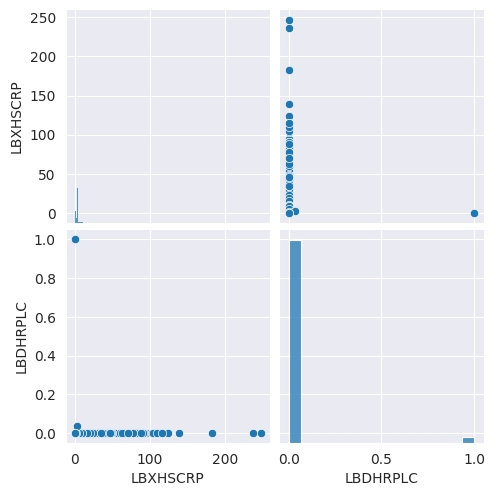

In [100]:
sns.pairplot(lab_data_c_pretain_fillna_mean)

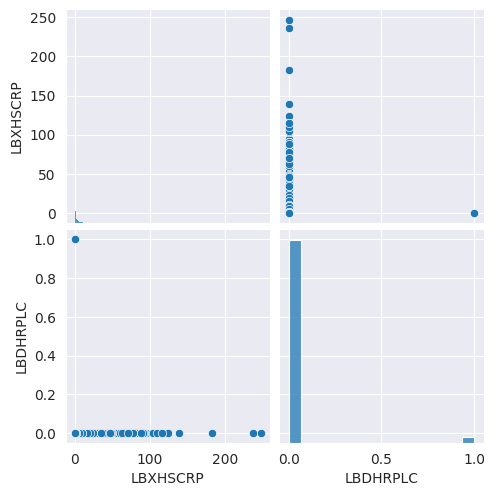

In [101]:
sns.pairplot(lab_data_c_pretain_fillna_median)

PCA and Kmeans

[0 4 4 ... 0 4 4]
[1 1 1 ... 1 1 1]
              0             1
0  4.440892e-16  6.938894e-18
1 -3.313894e+00  9.595348e-01
2 -3.112024e+00 -4.008939e-02
3 -2.702024e+00 -3.932258e-02
4 -2.692024e+00 -3.930387e-02
          0         1
0 -1.772656 -0.031851
1 -2.984319  0.966132
2 -2.782654 -0.033533
3 -2.372655 -0.032850
4 -2.362655 -0.032834
Min for every variable in C-reactive protein data filled in median:
LBXHSCRP    1.100000e-01
LBDHRPLC    5.397605e-79
dtype: float64
Max for every variable in C-reactive protein data filled in median:
LBXHSCRP    246.86
LBDHRPLC      1.00
dtype: float64
Min for every variable in C-reactive protein data filled in mean:
LBXHSCRP    1.100000e-01
LBDHRPLC    5.397605e-79
dtype: float64
Max for every variable in C-reactive protein data filled in mean:
LBXHSCRP    246.86
LBDHRPLC      1.00
dtype: float64


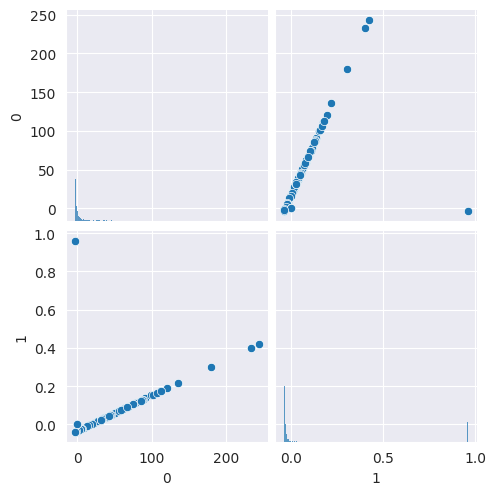

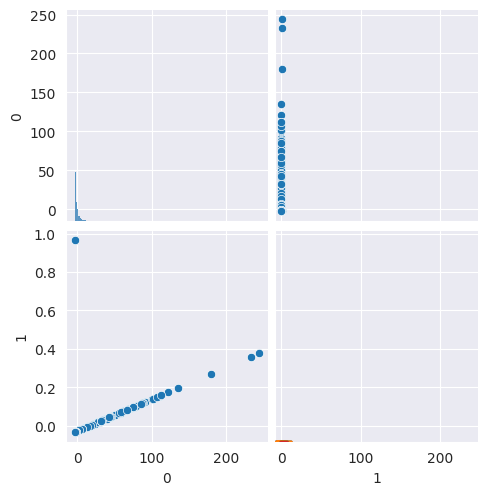

In [102]:
# prompt: kmeans for lab_data_c_preotain

clusters = 8

kmeans4 = KMeans(n_clusters = clusters)
kmeans4.fit(lab_data_c_pretain_fillna_mean)

print(kmeans4.labels_)

clusters = 8

kmeans5 = KMeans(n_clusters = clusters)
kmeans5.fit(lab_data_c_pretain_fillna_median)

print(kmeans5.labels_)

pca4 = PCA(2) # Reduced to 2 components as we only have two features
pca4.fit(lab_data_c_pretain_fillna_mean)

pca_data4 = pd.DataFrame(pca4.transform(lab_data_c_pretain_fillna_mean))

print(pca_data4.head())

pca5 = PCA(2) # Reduced to 2 components as we only have two features
pca5.fit(lab_data_c_pretain_fillna_median)

pca_data5 = pd.DataFrame(pca5.transform(lab_data_c_pretain_fillna_median))

print(pca_data5.head())

sns.pairplot(pca_data4)
sns.pairplot(pca_data5)

sns.kdeplot(data=pca_data4, x=0, y=1)
sns.kdeplot(data=pca_data5, x=0, y=1)

sns.kdeplot(data=kmeans4.labels_)
sns.kdeplot(data=kmeans5.labels_)

print("Min for every variable in C-reactive protein data filled in median:")
print(lab_data_c_pretain_fillna_median.min())
print("Max for every variable in C-reactive protein data filled in median:")
print(lab_data_c_pretain_fillna_median.max())

print("Min for every variable in C-reactive protein data filled in mean:")
print(lab_data_c_pretain_fillna_mean.min())
print("Max for every variable in C-reactive protein data filled in mean:")
print(lab_data_c_pretain_fillna_mean.max())

lab_data_c_pretain_fillna_median.to_csv('/content/drive/MyDrive/Lab_C_pretain_Fill_median.csv')
lab_data_c_pretain_fillna_mean.to_csv('/content/drive/MyDrive/Lab_C_pretain_Fill_mean.csv')

In [104]:
import xgboost as xgb
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error

# Assuming 'lab_data_c_pretain_fillna_mean' is your DataFrame
# and  to predict 'LBXHSCRP'

# Define features (X) and target (y)
X = lab_data_c_pretain_fillna_mean.drop('LBXHSCRP', axis=1)
y = lab_data_c_pretain_fillna_mean['LBXHSCRP']

# Split data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Initialize XGBoost regressor
model = xgb.XGBRegressor(objective='reg:squarederror', random_state=42)

# Train the model
model.fit(X_train, y_train)

# Make predictions
y_pred = model.predict(X_test)

# Evaluate the model
rmse = np.sqrt(mean_squared_error(y_test, y_pred))
print(f"Root Mean Squared Error: {rmse}")
MAE = np.mean(np.abs(y_test - y_pred))
print(f"Mean Absolute Error (MAE): {MAE}")
MSE = np.mean((y_test - y_pred) ** 2)
print(f"Mean Squared Error (MSE): {MSE}")

Root Mean Squared Error: 5.306038371223333
Mean Absolute Error (MAE): 2.600303360800316
Mean Squared Error (MSE): 28.154043196894364


In [105]:
import xgboost as xgb
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error

# Assuming 'lab_data_c_pretain_fillna_mean' is your DataFrame
# and  to predict 'LBXHSCRP'

# Define features (X) and target (y)
X = lab_data_c_pretain_fillna_median.drop('LBXHSCRP', axis=1)
y = lab_data_c_pretain_fillna_median['LBXHSCRP']

# Split data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Initialize XGBoost regressor
model = xgb.XGBRegressor(objective='reg:squarederror', random_state=42)

# Train the model
model.fit(X_train, y_train)

# Make predictions
y_pred = model.predict(X_test)

# Evaluate the model
rmse = np.sqrt(mean_squared_error(y_test, y_pred))
print(f"Root Mean Squared Error: {rmse}")
MAE = np.mean(np.abs(y_test - y_pred))
print(f"Mean Absolute Error (MAE): {MAE}")
MSE = np.mean((y_test - y_pred) ** 2)
print(f"Mean Squared Error (MSE): {MSE}")

Root Mean Squared Error: 5.356979223165201
Mean Absolute Error (MAE): 2.779866747532912
Mean Squared Error (MSE): 28.697226397423638


In [108]:
lab_data_cleaned_merged_mean =pd.concat([lab_data_cholesterol_fillna_mean,lab_blood_analysis_fillna_mean,lab_data_c_pretain_fillna_mean], axis=1)

In [109]:
lab_data_cleaned_merged_median =pd.concat([lab_data_cholesterol_fillna_median,lab_blood_analysis_fillna_median,lab_data_c_pretain_fillna_median], axis=1)

In [110]:
lab_data_cleaned_merged_mean.to_csv('/content/drive/MyDrive/Lab_data_cleaned_merged_mean.csv')

In [111]:
lab_data_cleaned_merged_median.to_csv('/content/drive/MyDrive/Lab_data_cleaned_merged_median.csv')